<a href="https://colab.research.google.com/github/ksureshprojects/Projects/blob/master/Supervised%20Learning/RNN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Recurrent Neural Networks

RNNs provide a way for sequential data to be captured in a meaningful way. Specifically, RNNs that are created using LSTM cells enable both long and short term behavior of a sequence to be taken into account when predicting the next value in a sequence. Unlike a conventional feed forward neural network, RNNs have the capacity to deal with input data that don't have fixed shapes or lengths. The example in this notebook looks at generating music that is similar to a given set of input songs. It builds on the activity outlined in the first Lab session of MIT's Introduction to Deep Learning course (6.S191).

### LSTM Cells

LSTM cells are gated cells that have a cell state and a hidden state. The cell state typically acts like a selective memory value that can keep track of information even if it was first recorded in an input several time steps prior. Information in the cell state persists from one input iteration to the next until the network deems there is a reason to 'forget' certain information. Conversely, the hidden state of a cell preserves a more holistic picture of the inputs seen by the network and is more sensitive to new inputs. The functions of both states are also closely linked to how they are updated. Applying gradient descent by backpropogating through time to update parameters that are used to calculate hidden states involves matrix multiplication. This results in the 'vaninshing gradient' problem as gradient magnitudes diminish as backpropogation goes further back in time. Conversely, the update proceedure for cell states does not invlove matrix multiplication so there is no loss in resolution as parameters are updated back through time. 

#### Loading Libraries

In [2]:
! pip install regex

     |████████████████████████████████| 655kB 2.9MB/s 
  Created wheel for regex: filename=regex-2019.8.19-cp36-cp36m-linux_x86_64.whl size=609220 sha256=bf2837958174bc80fee947ce737350fdf69414757370af63326f4095f1e66124
  Stored in directory: /root/.cache/pip/wheels/90/04/07/b5010fb816721eb3d6dd64ed5cc8111ca23f97fdab8619b5be
Successfully built regex


In [0]:
!apt-get install abcmidi timidity > /dev/null 2>&1

In [0]:
import tensorflow as tf 
tf.enable_eager_execution()

import numpy as np
import functools
import regex as re
import os
import urllib.request
import time


In [32]:
urllib.request.urlretrieve('https://raw.githubusercontent.com/ksureshprojects/introtodeeplearning_labs_python3/master/__init__.py', 'util.py')

('util.py', <http.client.HTTPMessage at 0x7fbce085ea90>)

In [0]:
import util

In [5]:
print('tf version: {}'.format(tf.__version__))

tf version: 1.14.0


In [0]:
is_correct_tf_version = '1.14.0' in tf.__version__
assert is_correct_tf_version, "Wrong tensorflow version ({}) installed".format(tf.__version__)

is_eager_enabled = tf.executing_eagerly()
assert is_eager_enabled,      "Tensorflow eager mode is not enabled"

# Check gpu is available in runtime
assert tf.test.is_gpu_available()

#### Getting Data

The data used to train our music generating model is a 'abc' file containing several irish tunes. The 'abc' file format provides a specification to represent musical tunes in plain text.

In [7]:
path_to_file = tf.keras.utils.get_file('irish.abc', 'https://raw.githubusercontent.com/aamini/introtodeeplearning_labs/2019/lab1/data/irish.abc')
text = open(path_to_file).read()
# length of text is the number of characters in it
print ('Length of text: {} characters'.format(len(text)))

204800/197618 [===============================] - 0s 0us/step
Length of text: 197618 characters


Each tune specified in a file has a set of headers that describe certain features of the tune such as composer name, time signature, and key. These headers are then followed by the musical notes and rests that actually make up the tune.

In [8]:
print(text[:504])

X:1
T:Alexander's
Z: id:dc-hornpipe-1
M:C|
L:1/8
K:D Major
(3ABc|dAFA DFAd|fdcd FAdf|gfge fefd|(3efe (3dcB A2 (3ABc|!
dAFA DFAd|fdcd FAdf|gfge fefd|(3efe dc d2:|!
AG|FAdA FAdA|GBdB GBdB|Acec Acec|dfaf gecA|!
FAdA FAdA|GBdB GBdB|Aceg fefd|(3efe dc d2:|!

X:2
T:An Buachaill Dreoite
Z: id:dc-hornpipe-2
M:C|
L:1/8
K:G Major
GF|DGGB d2GB|d2GF Gc (3AGF|DGGB d2GB|dBcA F2GF|!
DGGB d2GF|DGGF G2Ge|fgaf gbag|fdcA G2:|!
GA|B2BG c2cA|d2GF G2GA|B2BG c2cA|d2DE F2GA|!
B2BG c2cA|d^cde f2 (3def|g2gf gbag|fdcA G2:|!




The following functions are required to validate the format of tunes specified in an abc file and then play each tune.

In [0]:
file = open('abc2wav','a')
cmd = 'abcfile=$1\nsuffix=${abcfile%.abc}\nabc2midi $abcfile -o \"$suffix.mid\"\ntimidity \"$suffix.mid\" -Ow \"$suffix.wav\"\nrm \"$suffix.abc\" \"$suffix.mid\"'
file.write(cmd)
file.close()

In [0]:
! chmod +x abc2wav

In [0]:
def extract_song_snippet(generated_text):
    pattern = '\n\n(.*?)\n\n'
    search_results = re.findall(pattern, generated_text, overlapped=True, flags=re.DOTALL)
    songs = [song for song in search_results]
    print("Found {} possible songs in generated texts".format(len(songs)))
    return songs

def save_song_to_abc(song, filename="tmp"):
    save_name = "{}.abc".format(filename)
    with open(save_name, "w") as f:
        f.write(song)
    return filename

def abc2wav(abc_file):
    path_to_tool = './abc2wav'
    cmd = "{} {}".format(path_to_tool, abc_file)
    return os.system(cmd)

def play_wav(wav_file):
    from IPython.display import Audio
    return Audio(wav_file)

def play_generated_song(generated_text):
    songs = extract_song_snippet(generated_text)
    if len(songs) == 0:
        print("No valid songs found in generated text. Try training the model longer or increasing the amount of generated music to ensure complete songs are generated!")

    for song in songs:
        basename = save_song_to_abc(song)
        ret = abc2wav(basename+'.abc')
        if ret == 0: #succeeded
            return play_wav(basename+'.wav')
    print("None of the songs were valid, try training longer to improve syntax.")

In [12]:
play_generated_song(text)

Found 816 possible songs in generated texts


#### Preparing Data

The data needs to be converted from plain text into a vector. This can be achieved by mapping each unique character in the input text to a unique index.

In [13]:
# The unique characters in the file
vocab = sorted(set(text))
print('{} unique characters'.format(len(vocab)))

83 unique characters


In [0]:
# Creating a mapping from unique characters to indices
char2idx = {u:i for i, u in enumerate(vocab)}
text_as_int = np.array([char2idx[c] for c in text])

# Create a mapping from indices to characters
idx2char = np.array(vocab)

#### Creating Training Examples and Targets

As previously seen the input text contains 197618 chracters. The RNN requires a set of input and target sequences on which it can train itself to output a probability distribution of the next character, given an input sequence. For an input sequence of length `seq_length`, the target sequence will also be of the same length but shifted forward by one character. So if a `seq_length` equalled 4 and we had a the text 'Hello', an input sequence could be 'Hell' and the corresponding target sequence would be 'ello'.

In [15]:
# The maximum length sentence we want for a single input in characters.
seq_length = 100
examples_per_epoch = len(text)//seq_length
examples_per_epoch

1976

Choosing `seq_length` 100 gives us 1976 examples to train our model with. The choice is somewhat arbritary as `seq_length` only determines the number of examples available to the model for training. A greater value would mean fewer examples however, this should not effect the accuracy of the model as for every new input target pair, the parameter weights from the previous example are used as the starting values. Longer sequences only mean longer training times per example as. the process of backprpogation through time occurs over a greater number of steps.

In [0]:
def split_input_target(chunk):
    input_text =  chunk[:-1]
    target_text = chunk[1:]
    return input_text, target_text

In [17]:
# Create training examples & targets

char_dataset = tf.data.Dataset.from_tensor_slices(text_as_int)
print(char_dataset)
sequences = char_dataset.batch(seq_length+1, drop_remainder=True)
print(sequences)
dataset = sequences.map(split_input_target)
print(dataset)
for inp, target in dataset.take(1):
  [print('in: {}, out: {}'.format(inp_c, out_c)) for inp_c, out_c in zip(inp[:5], target[:5])]

<DatasetV1Adapter shapes: (), types: tf.int64>
<DatasetV1Adapter shapes: (101,), types: tf.int64>
<DatasetV1Adapter shapes: ((100,), (100,)), types: (tf.int64, tf.int64)>
in: 49, out: 22
in: 22, out: 13
in: 13, out: 0
in: 0, out: 45
in: 45, out: 22


For each of these vectors, each index is processed at a single time step. So, for the input at time step 0, the model receives the index for the first character in the sequence, and tries to predict the index of the next character. At the next timestep, it does the same thing, but the RNN considers the information from the previous step (i.e. its updated state, in addition to the current input).

Next, input and target examples are shuffled before being grouped into batches. Mini-batch gradient descent is the name for the process where weights of the model are updated after gradient descent is applied over subsets (batches) of the data rather than the entire data set. An epoch refers to one complete pass through the entire data set. If the data is not split into batches, the model's weights will only be updated once over an epoch. Conversely, if the data was split into batches and the weights of the model are updated after performing gradient descent over each batch, the weights of the model are updated more than once over a single epoch (`steps_per_epoch`). This means for a given number of epochs, the model achieves a much better level of training when trained over batches. 

The data is shuffled before being grouped into batches to ensure that the model does not overfit to any pre-existing structure in the order of the input data. Batches should be formed by uniformly sampling from the entire dataset.

###### Note: 
When plotting average cost vs iterations, to evaluate how the model improves over its training, the plot should always be decreasing if carrying out normal gradient descent over the entire dataset. However, when carrying out mini-batch gradient descent, as average costs are calculated over the batch, and each batch contains different sets of input and target examples, even though the plot's general trend should be decreasing the plot can be more oscilliatory. This is because the data points in two successive batches could have differences that outweigh the improvement in model weights.

###### Comparing the Extremes: 
For a data set with `m` points, choosing a batch size of `m` is the same as carrying out ordinary gradient descent. The result will always converge, but the process takes too long per iteration. Choosing a batch size of `1` is equivalent to carrying out stachastic gradient descent. Stochastic gradient descent is an extremely noisy process and will never converge to a local minimum. However, this could be overcome by fiddling with the learning rate of the model or using a decaying learning rate algortithm. The main issue with stochatic gradient descent is that all the speed gains due to vectorisation are lost as each data point is processed independently.

###### Guidelines To Choosing Mini-Batch Size:
- Choose a power of two, generally between $2^6$ (64) and and $2^9$ (512). Powers of two tend to work better due to the way computer memory is organised.

In [18]:
# Batch size (hyperparameter)
BATCH_SIZE = 64
steps_per_epoch = examples_per_epoch//BATCH_SIZE
print(steps_per_epoch)

30


In [19]:


# Buffer size is similar to a queue size
# This defines a manageable data size to put into memory, where elements are shuffled
BUFFER_SIZE = 10000

dataset = dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE, drop_remainder=True)

# Examine the dimensions of the dataset
dataset

<DatasetV1Adapter shapes: ((64, 100), (64, 100)), types: (tf.int64, tf.int64)>

#### Embeddings
Each `word` in the data's vocabulary can be mapped to a dense vector of dimension `embedding-dim`. The position of a `word` within the vector space is learned from text and is based on the `words` that surround the `word` when it is used. The position of a `word` in the learned vector space is referred to as its `embedding`. The Embedding layer is initialized with random weights and will learn an embedding for all of the words in the training dataset.

It is a flexible layer that can be used in a variety of ways, such as:

- It can be used alone to learn a word embedding that can be saved and used in another model later.
- It can be used as part of a deep learning model where the embedding is learned along with the model itself.
- It can be used to load a pre-trained word embedding model, a type of transfer learning.


In [0]:
# The embedding dimension (hyperparameter)
embedding_dim = 256

#### Building Model

In [0]:
# Length of the vocabulary in chars
vocab_size = len(vocab)

# The number of RNN units (hyperparameter)
rnn_units = 1024

if tf.test.is_gpu_available():
  LSTM = tf.keras.layers.CuDNNLSTM
else:
  # Pre-defines function call with args specified into callable object
  LSTM = functools.partial(
    tf.keras.layers.LSTM, recurrent_activation='sigmoid')

LSTM = functools.partial(LSTM, 
  return_sequences=True, 
  recurrent_initializer='glorot_uniform',
  stateful=True
)

In [0]:
def build_model(vocab_size, embedding_dim, rnn_units, batch_size):
  model = tf.keras.Sequential([
    tf.keras.layers.Embedding(vocab_size, embedding_dim, 
                              batch_input_shape=[batch_size, None]),
    LSTM(rnn_units), # Define the dimensionality of the RNN
    tf.keras.layers.Dense(vocab_size) # Define the dimensionality of the Dense layer
  ])

  return model

In [22]:
model = build_model(vocab_size, embedding_dim, rnn_units, BATCH_SIZE)
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding (Embedding)        (64, None, 256)           21248     
_________________________________________________________________
cu_dnnlstm (CuDNNLSTM)       (64, None, 1024)          5251072   
_________________________________________________________________
dense (Dense)                (64, None, 83)            85075     
Total params: 5,357,395
Trainable params: 5,357,395
Non-trainable params: 0
_________________________________________________________________


#### Validating Outout Format

In [23]:
# Check dimensions of model output. Note input can be any length
for input_example_batch, target_example_batch in dataset.take(1): 
  example_batch_predictions = model(input_example_batch)
  print(example_batch_predictions.shape, "# (batch_size, sequence_length, vocab_size)")

(64, 100, 83) # (batch_size, sequence_length, vocab_size)


In [26]:
# Sampling from predicted distributions
sampled_indices = tf.random.categorical(example_batch_predictions[0], num_samples=1)
# Given a tensor input, this operation returns a tensor of the same type with all dimensions of size 1 removed. 
sampled_indices = tf.squeeze(sampled_indices,axis=-1).numpy()
print("Input: \n", repr("".join(idx2char[input_example_batch[0]])))
print()
print("Next Char Predictions: \n", repr("".join(idx2char[sampled_indices])))

Input: 
 '\nBGE E3|BGE FGA|BGE BGE|AFD DFA|!\nBGE E3|BGE FGA|dcB ABG|FDF AGF:|!\nEGB efg|fed edB|EGB EFG|F3 AGF|!'

Next Char Predictions: 
 'Z7uw!ede8/ZtbdlO#1uM:9yeLIxtM[k3cOElsv|Y3qSObOtxi|WjwT8GM=n\'S=]Q0R:NNePuy=t(EM\'x_6fYwSg=tZn"Y>h:lbTq'


#### Training Model

In [0]:
# Negative log likelihood loss
def compute_loss(labels, logits):
  return tf.keras.backend.sparse_categorical_crossentropy(labels, logits, from_logits=True)


###### Possible Optimizers:
`AdamOptimizer`, `AdagradOptimizer`, and `MomentumOptimizer`.

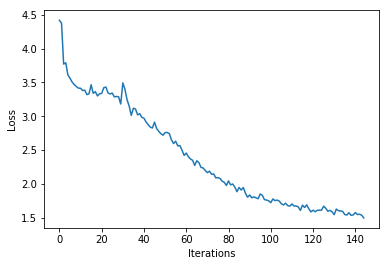

N/A%|#                                              |Time:  0:00:06  Loss: 1.48


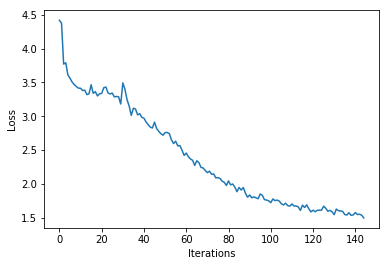

In [38]:
# Training step
EPOCHS = 5 
# How does changing this affect the network's performance?
optimizer = tf.train.AdamOptimizer()
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt_{epoch}")

history = []
plotter = util.PeriodicPlotter(sec=1, xlabel='Iterations', ylabel='Loss')
for epoch in range(EPOCHS):
    start = time.time()

    # Initialize the hidden state at the start of every epoch; initially is None
    hidden = model.reset_states()
    
    # Enumerate the dataset for use in training
    custom_msg = util.custom_progress_text("Loss: %(loss)2.2f")
    bar = util.create_progress_bar(custom_msg)
    for inp, target in bar(dataset):
        # Use tf.GradientTape()
        with tf.GradientTape() as tape:
            '''TODO: feed the current input into the model and generate predictions'''
            predictions = model(inp) # TODO
            '''TODO: compute the loss!'''
            loss = compute_loss(target, predictions)
        
        # Now, compute the gradients and try to minimize
        '''TODO: complete the function call for gradient computation'''
        grads = tape.gradient(loss, model.trainable_variables) # TODO
        optimizer.apply_gradients(zip(grads, model.trainable_variables))
        
        # Update the progress bar!
        history.append(loss.numpy().mean())
        custom_msg.update_mapping(loss=history[-1])
        plotter.plot(history)
        
    # Update the model with the changed weights!
    model.save_weights(checkpoint_prefix.format(epoch=epoch))


#### Generative Model

A new model can be created to generate characters of an `abc` file given an initial seed. Unlike the trained model, the generative model is configured to take a single character as an input and then outputs the distribution for the next character in the sequence. The parameters of the generative model are initialised to the parameters of the trained model. 

In [50]:
model = build_model(vocab_size, embedding_dim, rnn_units, batch_size=1)

model.load_weights(tf.train.latest_checkpoint(checkpoint_dir))

model.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_2 (Embedding)      (1, None, 256)            21248     
_________________________________________________________________
cu_dnnlstm_2 (CuDNNLSTM)     (1, None, 1024)           5251072   
_________________________________________________________________
dense_2 (Dense)              (1, None, 83)             85075     
Total params: 5,357,395
Trainable params: 5,357,395
Non-trainable params: 0
_________________________________________________________________


In [0]:
def generate_text(model, start_string, generation_length=1000):
  # Evaluation step (generating ABC text using the learned RNN model)
  input_eval = np.array([char2idx[c] for c in start_string])
  input_eval = tf.expand_dims(input_eval, 0)

  # Empty string to store our results
  text_generated = []

  # Here batch size == 1
  model.reset_states()
  bar = util.create_progress_bar()
  for i in bar(range(generation_length)):
      # Make prediction of next charcters probability distribution
      predictions = model(input_eval)
      
      # Remove the batch dimension
      predictions = tf.squeeze(predictions, 0)
      
      # Use multinomial distribution to sample data
      predicted_id = tf.random.categorical(predictions, num_samples=1)[-1,0].numpy() 
      
      # Pass the prediction as the next inputs to the model.
      input_eval = tf.expand_dims([predicted_id], 0)
      
      # Use index to character map
      text_generated.append(idx2char[predicted_id]) # TODO 

  return (start_string + ''.join(text_generated))

In [52]:
# ABC files start with "X" - this is a good start string
text = generate_text(model, 'X')

100%|#########################################################|Time:  0:00:07  


In [53]:
play_generated_song(text)

Found 1 possible songs in generated texts
